**Image Processing Laboratory (045108) - Meeting 2/4**  

Signal and Image Processing Lab (SIPL) & Vision and Image Sciences Lab (VISL)  
The Andrew and Erna Viterbi Faculty of Electrical and Computer Engineering    
Technion - Israel Institute of Technology

In [78]:
import os
import numpy as np
import matplotlib.pyplot as plt
from skimage import color, io, filters, metrics, transform, util
import rawpy
from lab_code import flir_image_extractor

# Set to True to run the notebook without waiting for user interaction
DISABLE_GUI = False


# Helper Functions

In [79]:
def visual_prep(filename, convert_to_grayscale=True, target_width = 1600):
    """
    Prepare an image for the lab: read it, optionally convert to grayscale, and
    downscale it to a target width.

    Args:
        filename (str): Path to the image file.
        convert_to_grayscale (bool, optional): Whether to convert to grayscale.
            Default: True.
        target_width (int, optional): Maximum width in pixels. Images wider than this
            are downscaled with aspect ratio preserved; narrower images keep their
            original size. Default: 1600.

    Returns:
        numpy.ndarray: The processed image as uint8.
    """

    image = io.imread(filename)
    if image.ndim == 3 and image.shape[2] == 4:
        image = color.rgba2rgb(image)
    if convert_to_grayscale and image.ndim == 3:
        image = color.rgb2gray(image)

    height, width = image.shape[:2]

    # Resize to target_width while preserving aspect ratio
    if width > target_width:
        scale = target_width / width
        new_height = int(round (height * scale))
        image = transform.resize(image, (new_height, target_width), anti_aliasing=True)

    image = util.img_as_ubyte(image)

    return image


def thermal_prep(filename):
    """
    Prepare a FLIR thermal image for the lab by reading it.

    Args:
        filename (str): Path to the FLIR thermal image file.

    Returns:
        numpy.ndarray: The prepared thermal image as a 2D float array.
    """

    image_extractor = flir_image_extractor.FlirImageExtractor()
    image_extractor.process_image(filename)
    thermal = image_extractor.extract_thermal_image()

    return thermal


def thermal_prep_uint8(filename, vmin=None, vmax=None, clip_percentiles=(2, 98)):
    """
    Prepare a FLIR thermal image for the lab by reading it and mapping its dynamic range
    to uint8.

    Args:
        filename (str): Path to the FLIR thermal image file.
        vmin/vmax (float, optional): Lower/upper raw thermal values to map to 0/255. If
            either is 'None', it is inferred from the specified 'clip_percentiles'.
            Default: None.
        clip_percentiles ((float, float), optional): Percentiles (low, high) in [0, 100]
            used to infer 'vmin'/'vmax' when not provided. Default: (2, 98).

    Returns:
        numpy.ndarray: The thermal image mapped to uint8.
    """

    thermal = thermal_prep(filename).astype(np.float32)

    # Auto-select vmin/vmax if not provided
    if vmin is None or vmax is None:
        lo, hi = np.percentile(thermal, clip_percentiles)
        vmin = lo if vmin is None else vmin
        vmax = hi if vmax is None else vmax

    scaled = (thermal - vmin) * (255.0 / max(1e-6, (vmax - vmin)))
    return np.clip(scaled, 0, 255).astype(np.uint8)


# Assignment 1 - Color Images

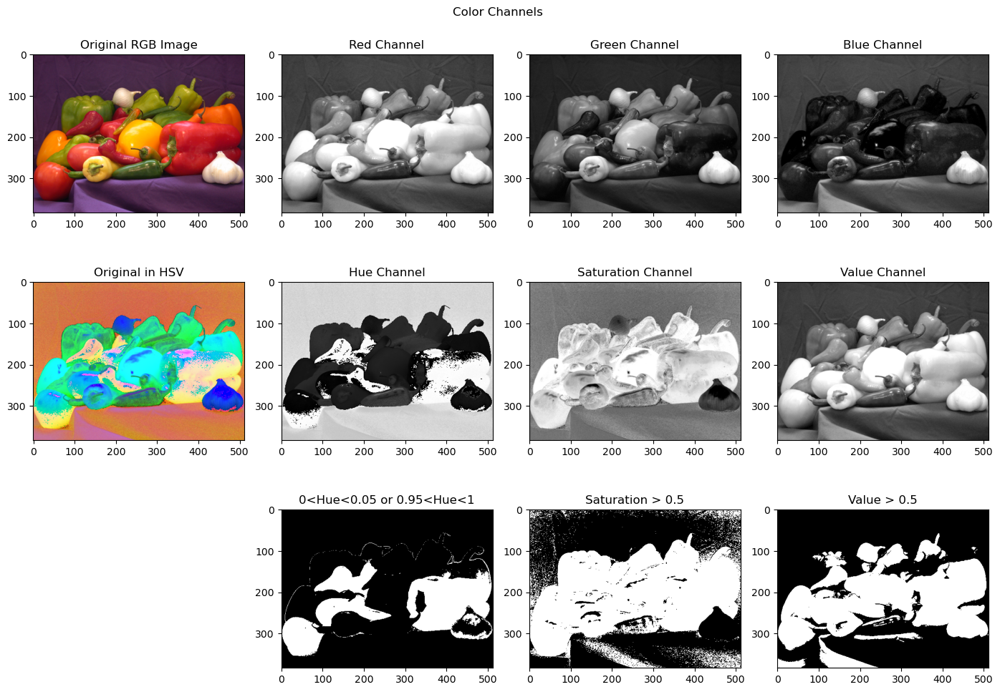

In [80]:
# Question 1

# Load the image
peppers_image = io.imread('C:/Users/ompal/Desktop/meet2/images/peppers.png')

# Convert from RGB to HSV
peppers_hsv = color.rgb2hsv(peppers_image)

# Split color channels
peppers_r = peppers_image[:,:,0]
peppers_g = peppers_image[:,:,1]
peppers_b = peppers_image[:,:,2]
peppers_h = peppers_hsv[:,:,0]
peppers_s = peppers_hsv[:,:,1]
peppers_v = peppers_hsv[:,:,2]

# Show color channels
plt.figure(figsize=(14, 10))
plt.suptitle('Color Channels')

plt.subplot(3,4,1); plt.imshow(peppers_image); plt.title('Original RGB Image')
plt.subplot(3,4,2); plt.imshow(peppers_r, cmap='gray'); plt.title('Red Channel')
plt.subplot(3,4,3); plt.imshow(peppers_g, cmap='gray'); plt.title('Green Channel')
plt.subplot(3,4,4); plt.imshow(peppers_b, cmap='gray'); plt.title('Blue Channel')

plt.subplot(3,4,5); plt.imshow(peppers_hsv); plt.title('Original in HSV')
plt.subplot(3,4,6); plt.imshow(peppers_h, cmap='gray'); plt.title('Hue Channel')
plt.subplot(3,4,7); plt.imshow(peppers_s, cmap='gray'); plt.title('Saturation Channel')
plt.subplot(3,4,8); plt.imshow(peppers_v, cmap='gray'); plt.title('Value Channel')

plt.subplot(3,4,10); plt.imshow(np.logical_or(peppers_h > 0.95, peppers_h < 0.05), cmap='gray'); plt.title('0<Hue<0.05 or 0.95<Hue<1')
plt.subplot(3,4,11); plt.imshow(peppers_s > 0.5, cmap='gray'); plt.title('Saturation > 0.5')
plt.subplot(3,4,12); plt.imshow(peppers_v > 0.5, cmap='gray'); plt.title('Value > 0.5')

plt.tight_layout()
plt.show()


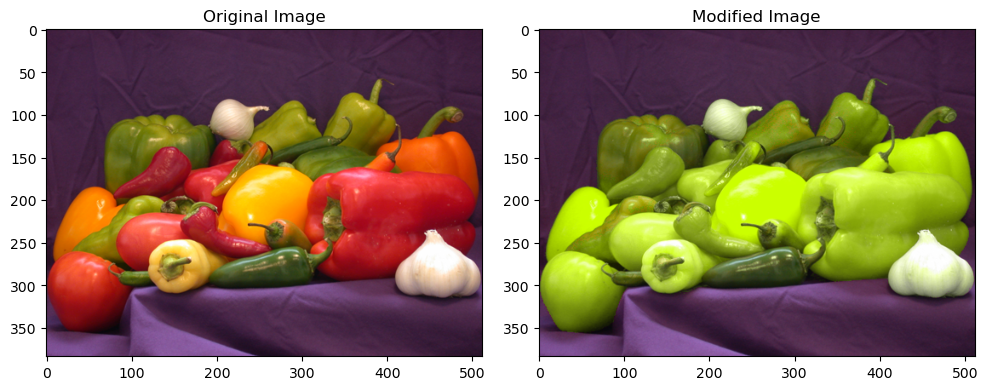

In [81]:
# Question 2

# Create a mask of peppers' hue values in a specific range
peppers_mask = np.logical_or(peppers_h >= 0.92, peppers_h <= 0.16)

#  Where the mask is True, set the hue values to a specific value, else don't change them
peppers_h_modified = np.where(peppers_mask, 0.2, peppers_h)

peppers_hsv_modified = peppers_hsv.copy()
peppers_hsv_modified[:, :, 0] = peppers_h_modified

# Convert back to RGB colorspace
peppers_modified_rgb = color.hsv2rgb(peppers_hsv_modified)

# Show original and modified image
plt.figure(figsize=(10,8))
plt.subplot(1,2,1)
plt.imshow(peppers_image)
plt.title('Original Image')

plt.subplot(1,2,2)
plt.imshow(peppers_modified_rgb)
plt.title('Modified Image')

plt.tight_layout()
plt.show()


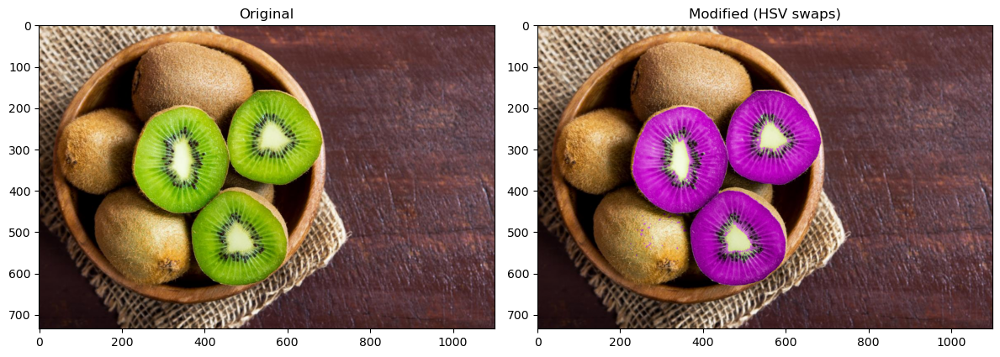

In [82]:
# Question 3

# TODO: Write code that uses the HSV colorspace to change the
#       dominant colors in the image you received from the instructor


instructor_image = io.imread('C:/Users/ompal/Desktop/meet2/images/kiwi.jpg')  

# 2) Convert to HSV like section 1
instructor_hsv = color.rgb2hsv(instructor_image)

# 3) Split channels
hue = instructor_hsv[:, :, 0]   # Hue   ∈ [0,1]
s = instructor_hsv[:, :, 1]   # Sat.
v = instructor_hsv[:, :, 2]   # Value

# To filter channels which aren't so colorful
sat_mask = s > 0.4

# block pixels in those ranges
### mask_red   = np.logical_and(np.logical_or(hue <= 0.09, hue >= 0.91), sat_mask)
mask_green = np.logical_and(np.logical_and(hue >= 0.13, hue <= 0.45), sat_mask)
### mask_blue  = np.logical_and(np.logical_and(hue >= 0.55, hue <= 0.75), sat_mask)

# Those "blocked" pixels convert to the color:
### hue_target_for_red   = 0.33   
hue_target_for_green = 0.83   
### hue_target_for_blue  = 0.13   

# 5) the subtition itself
h_mod = hue.copy()  # creating a copy
### h_mod = np.where(mask_red,   hue_target_for_red,   h_mod)   
h_mod = np.where(mask_green, hue_target_for_green, h_mod)   
### h_mod = np.where(mask_blue,  hue_target_for_blue,  h_mod)   


instructor_hsv_modified = instructor_hsv.copy()  # creating copy of the original picture given to us
instructor_hsv_modified[:, :, 0] = h_mod  # subtituting the first channel in HSV (hue) with the one we just modified
instructor_image_modified = color.hsv2rgb(instructor_hsv_modified)  # converting back to regular RGB pressention


plt.figure(figsize=(12,5))
plt.subplot(1,2,1) 
plt.imshow(instructor_image)         
plt.title('Original')
plt.subplot(1,2,2) 
plt.imshow(instructor_image_modified) 
plt.title('Modified (HSV swaps)')
plt.tight_layout(); plt.show()






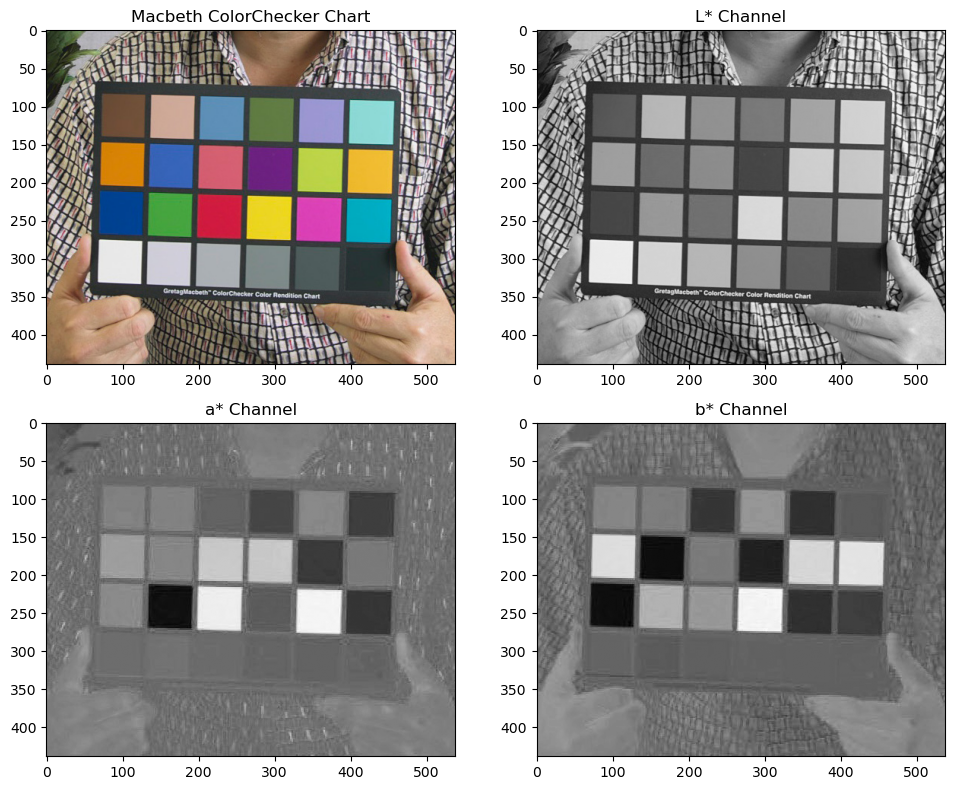

In [83]:
# Question 4

# Load the ColorChecker image
colorchecker = io.imread('C:/Users/ompal/Desktop/meet2/images/colorchecker.jpg')

# Convert to LAB colorspace
colorchecker_lab = color.rgb2lab(colorchecker)

# Show the original image and its LAB channels
plt.figure(figsize=(10, 8))

plt.subplot(2,2,1)
plt.imshow(colorchecker)
plt.title('Macbeth ColorChecker Chart')

channels = ['L*', 'a*', 'b*']
for i, channel in enumerate(channels):
    plt.subplot(2,2,i+2)
    plt.imshow(colorchecker_lab[:,:,i], cmap='gray')    # L*
    # plt.imshow(colorchecker_lab[:,:,1], cmap='gray', vmin=-128, vmax=127) # a*
    # plt.imshow(colorchecker_lab[:,:,2], cmap='gray', vmin=-128, vmax=127) # b*
    plt.title(f'{channel} Channel')

plt.tight_layout()
plt.show()


C:\Users\ompal\AppData\Local\Temp\ipykernel_21396\3581087512.py:55: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 2724 negative Z values that have been clipped to zero
  out_bswap = color.lab2rgb(lab_bswap)


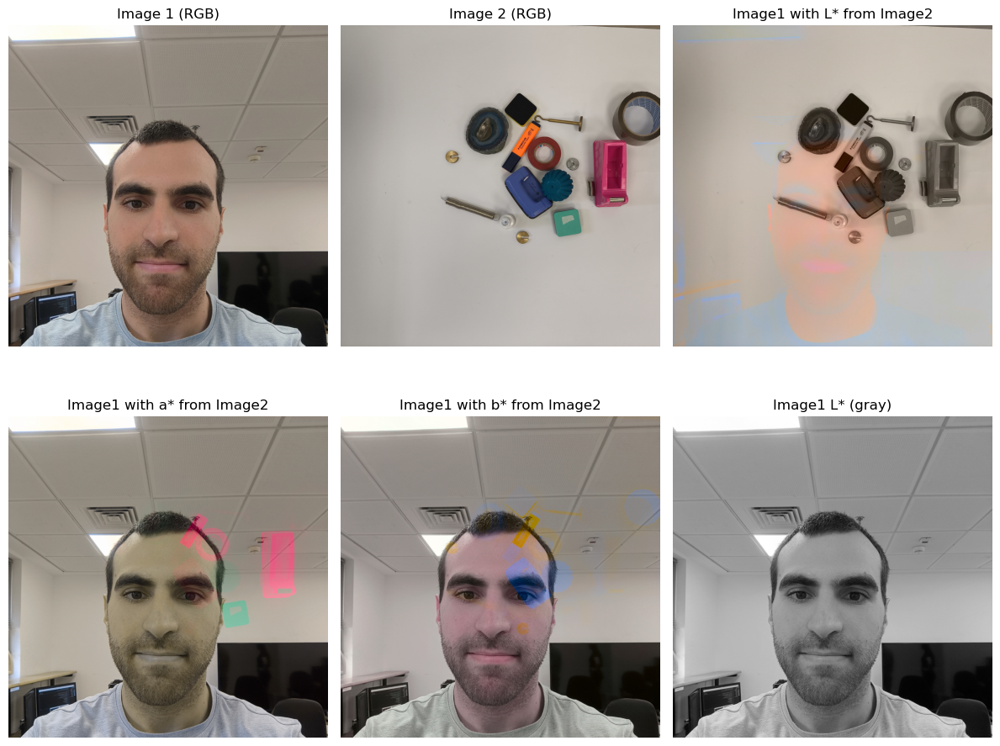

In [84]:
# Question 5

def crop_to_min_size(image1, image2):
    """
    Crops two images to their minimum size.

    Args:
        image1 (numpy.ndarray): The first image to crop.
        image2 (numpy.ndarray): The second image to crop.

    Returns:
        A tuple of two cropped images of type numpy.ndarray, both with the same dimensions.
    """
    # Determine the minimum height and width
    min_height = min(image1.shape[0], image2.shape[0])
    min_width = min(image1.shape[1], image2.shape[1])

    # Crop both images to the minimum size
    cropped_image1 = image1[:min_height, :min_width]
    cropped_image2 = image2[:min_height, :min_width]

    return cropped_image1, cropped_image2


# TODO: Read two of the visual images you took
visual_image1 = io.imread('C:/Users/ompal/Desktop/meet2/images/face.jpg')
visual_image2 = io.imread('C:/Users/ompal/Desktop/meet2/images/regular.jpg')

if visual_image1.ndim == 2:  
    visual_image1 = color.gray2rgb(visual_image1) 
if visual_image2.ndim == 2: 
    visual_image2 = color.gray2rgb(visual_image2) 


# Crop the two images to the same dimensions
cropped_visual_image1, cropped_visual_image2 = crop_to_min_size(visual_image1, visual_image2)

# TODO: convert the two images to the LAB colorspace
lab1 = color.rgb2lab(cropped_visual_image1)  
lab2 = color.rgb2lab(cropped_visual_image2)  
# TODO: Replace the L channel of the first image with the L channel of the
#       second image and show the result
lab_Lswap = lab1.copy()  
lab_Lswap[:, :, 0] = lab2[:, :, 0]  
out_Lswap = color.lab2rgb(lab_Lswap)  
# TODO: Replace the a channel of the first image with the a channel of the
#       second image and show the result
lab_aswap = lab1.copy()  
lab_aswap[:, :, 1] = lab2[:, :, 1]  
out_aswap = color.lab2rgb(lab_aswap)  
# TODO: Replace the b channel of the first image with the b channel of the
#       second image and show the result
lab_bswap = lab1.copy()  
lab_bswap[:, :, 2] = lab2[:, :, 2]  
out_bswap = color.lab2rgb(lab_bswap)  




plt.figure(figsize=(12,10))   
plt.subplot(2,3,1); plt.imshow(cropped_visual_image1); plt.title('Image 1 (RGB)'); plt.axis('off')
plt.subplot(2,3,2); plt.imshow(cropped_visual_image2); plt.title('Image 2 (RGB)'); plt.axis('off')
plt.subplot(2,3,3); plt.imshow(out_Lswap); plt.title('Image1 with L* from Image2'); plt.axis('off')
plt.subplot(2,3,4); plt.imshow(out_aswap); plt.title('Image1 with a* from Image2'); plt.axis('off')
plt.subplot(2,3,5); plt.imshow(out_bswap); plt.title('Image1 with b* from Image2'); plt.axis('off')
plt.subplot(2,3,6); plt.imshow(lab1[:,:,0], cmap='gray'); plt.title('Image1 L* (gray)'); plt.axis('off')

plt.tight_layout()
plt.show()                   

# Assignment 2 - Raw Image Processing

In [85]:
# Question 1

image_name = 'DSC00602'
raw_path  = f'images/{image_name}.arw'
jpeg_path = f'images/{image_name}.jpg'

# Read raw image and its metadata
with rawpy.imread(raw_path) as raw:
    raw_data = raw.raw_image_visible.copy()              # raw image without margins
    height, width = raw_data.shape
    cfa_pattern = raw.raw_pattern                        # one CFA pattern tile
    camera_wb = np.array(raw.camera_whitebalance[:3])    # white balance coefficients as shot
    white_level = raw.white_level                        # value at which a pixel is saturated
    black_levels = np.array(raw.black_level_per_channel) # per-channel black level

    # Perform demosaicing and color conversion
    rgb_image = raw.postprocess(use_camera_wb=True)

# Print image dimensions
print(f"Image dimensions: {width} x {height}")



Image dimensions: 6272 x 4168


In [86]:
# Question 2

# Print color depth
#raw_bit_depth = int(np.ceil(np.log2(white_level + 1)))   # infer bit depth from white level
#print(f"Color depth (per channel): {raw_bit_depth}-bit")

image_name = 'DSC00602'
raw_path = f'images/{image_name}.ARW'

with rawpy.imread(raw_path) as raw:
    
    white_level = raw.white_level

    
    raw_bit_depth = int(np.ceil(np.log2(white_level + 1)))
    print(f"Color depth (per channel): {raw_bit_depth}-bit")


Color depth (per channel): 14-bit


In [87]:
# Question 3

# Print CFA pattern
#color_map = {0: 'Red', 1: 'Green', 2: 'Blue', 3: 'Green'}
#color_pattern = np.vectorize(color_map.get)(cfa_pattern)
#print('Color Filter Array (CFA) pattern:')
#print(color_pattern)


image_name = 'DSC00602'
raw_path = f'images/{image_name}.ARW'

with rawpy.imread(raw_path) as raw:
    
    cfa_idx_tile = raw.raw_pattern.copy()               
    
    color_order = raw.color_desc.decode('ascii')        
    idx2name = {i: color_order[i] for i in range(len(color_order))}
    cfa_name_tile = np.vectorize(idx2name.get)(cfa_idx_tile)

print("CFA index tile:\n", cfa_idx_tile)
print("CFA named tile:\n", cfa_name_tile)

CFA index tile:
 [[0 1]
 [3 2]]
CFA named tile:
 [['R' 'G']
 ['G' 'B']]


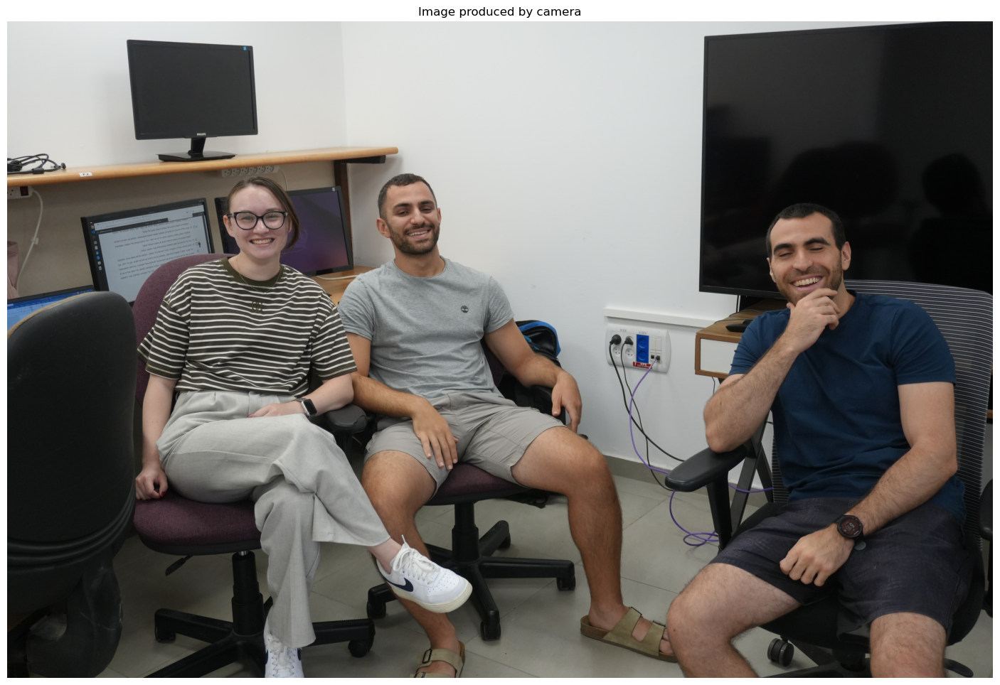

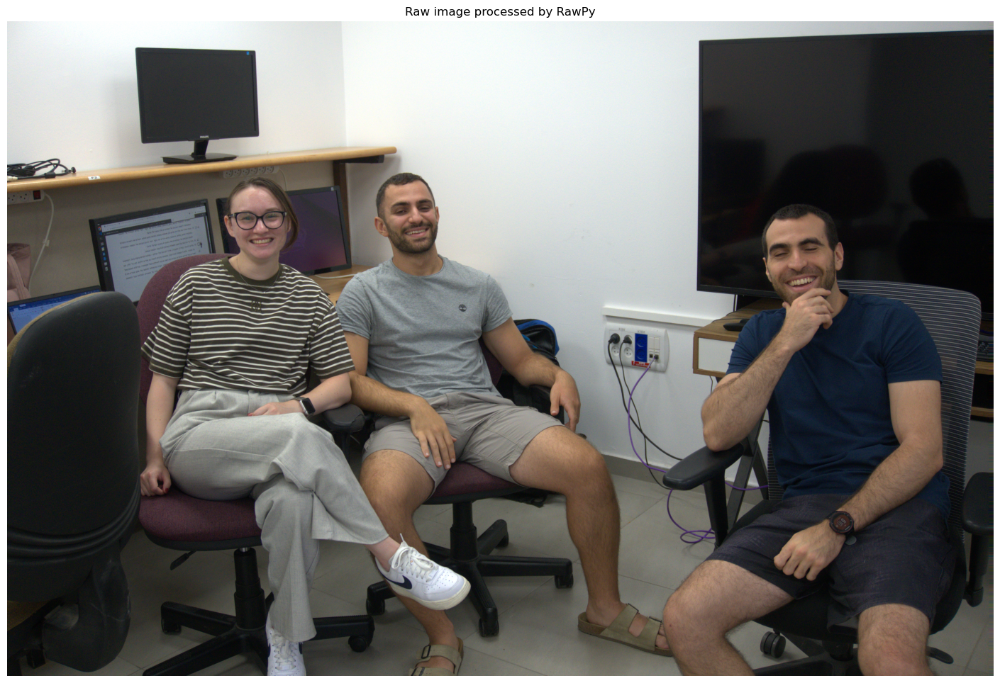

In [88]:
# Question 4

jpeg_image = io.imread(jpeg_path)
plt.figure(figsize=(18, 12))
plt.imshow(jpeg_image)
plt.axis('off')
plt.title('Image produced by camera')
plt.show()

plt.figure(figsize=(18, 12))
plt.imshow(rgb_image)
plt.axis('off')
plt.title('Raw image processed by RawPy')
plt.show()


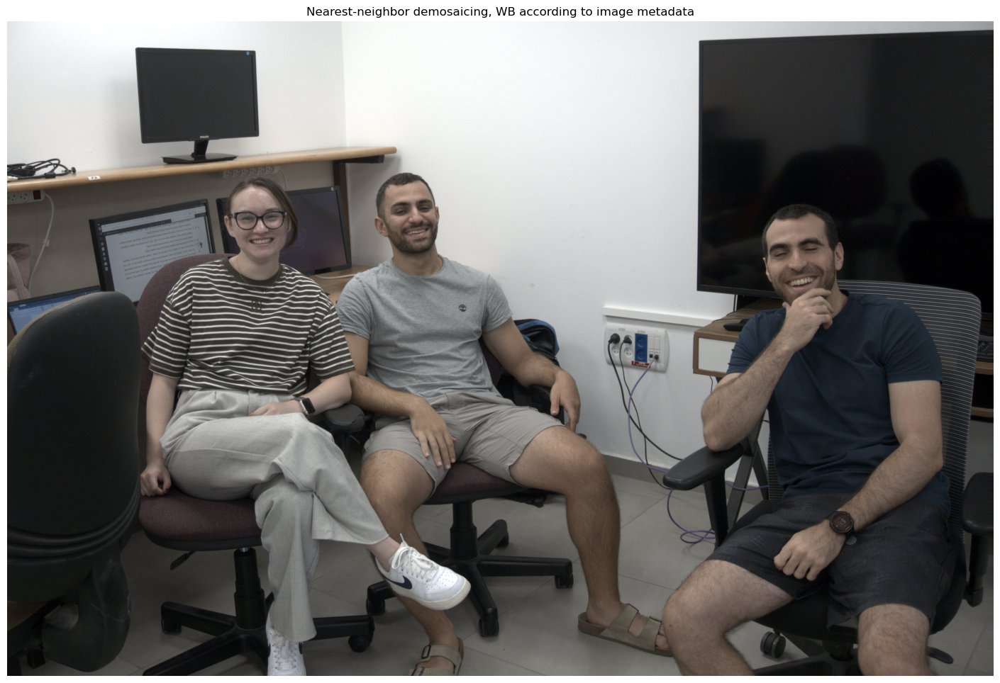

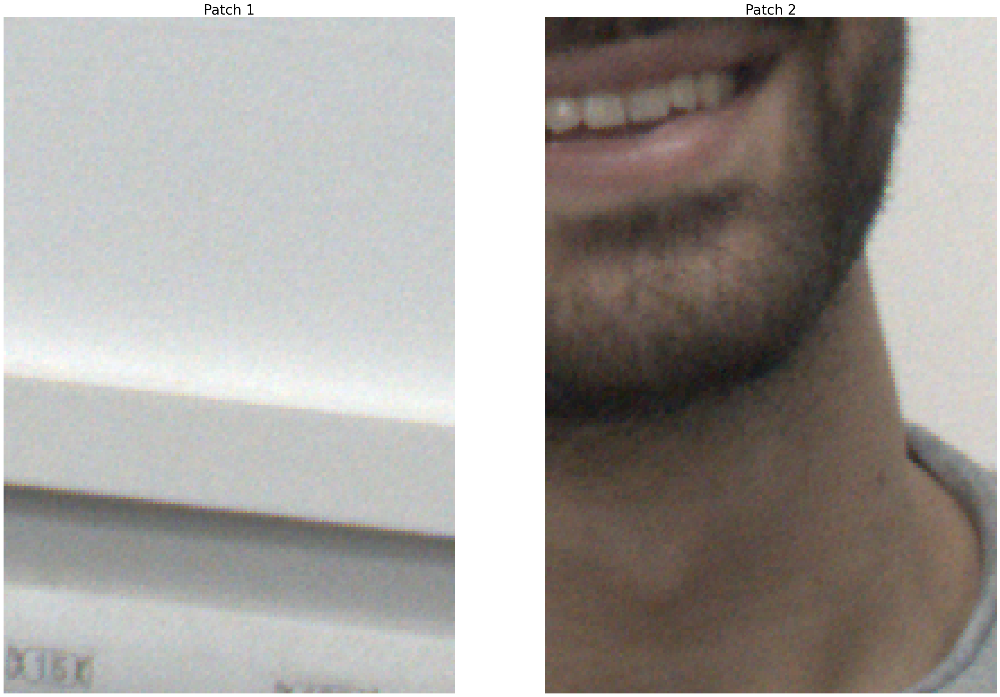

In [89]:
# Question 5


def create_cfa_masks(cfa_pattern, height, width):
    """
    Build full-image boolean masks for a 2x2 Color Filter Array (CFA) pattern.

    Args:
        cfa_pattern ((2, 2) np.ndarray): Integer-encoded CFA tile where:
         0 = Red, 1 = Green, 2 = Blue, 3 = Green (second green position).
        For example, an RGGB Bayer tile would be:
            [[0, 1],
             [1, 2]]
        height (int): Image height.
        width (int): Image width.

        Returns:
            list of np.ndarray of bool [r_mask, g_mask, b_mask], each with shape
            (height, width). True at locations of the corresponding color in the tiled
            CFA.
    """
    r_mask = (cfa_pattern == 0)                             # Red
    g_mask = (cfa_pattern == 1) | (cfa_pattern == 3)        # Green
    b_mask = (cfa_pattern == 2)                             # Blue
    masks = (r_mask,  g_mask, b_mask)

    pad_height, pad_width = (height + 1) // 2 * 2, (width + 1) // 2 * 2
    cfa_masks = [np.tile(mask, (pad_height // 2, pad_width // 2))[:height, :width] for mask in masks]

    return cfa_masks


def demosaic_channel_nn(data, cfa_mask):
    """
    Nearest-neighbor demosaicing of a single channel. Fills missing values by copying
    from the nearest pixel.

    Args:
        data(np.ndarray): Single-channel image with known values at CFA sample sites and
            arbitrary values elsewhere.
        cfa_mask(np.ndarray of bool): True where the value is known; False at missing
            sites.

    Returns:
        result(np.ndarray): Demosaiced image channel.
    """
    data = np.asarray(data)
    cfa_mask = np.asarray(cfa_mask, dtype=bool)

    # If all pixels are known, return a copy
    if cfa_mask.all():
        return data.astype(np.float32, copy=True)

    result = data.astype(np.float32, copy=True)
    height, width = data.shape

    # Get missing pixel positions
    Y, X = np.where(~cfa_mask)

    # Find reference position (nearest known pixel)
    known_Y, known_X = np.where(cfa_mask)
    ref_y, ref_x = known_Y[0], known_X[0]

    # Calculate relative position within the pattern
    Y_relative = np.abs(Y - ref_y) % 2
    X_relative = np.abs(X - ref_x) % 2
    Y_direction = np.where(Y >= ref_y, 1, -1)
    X_direction = np.where(X >= ref_x, 1, -1)

    # TODO: Calculate reference positions
    ref_Y = Y - Y_direction * Y_relative
    ref_X = X - X_direction * X_relative

    # Clip image bounds
    ref_Y = np.clip(ref_Y, 0, height - 1)
    ref_X = np.clip(ref_X, 0, width - 1)

    # TODO: Copy values from reference positions
    result[Y, X] = result[ref_Y, ref_X]

    return result


def white_balance_camera(image, black_levels, white_level, camera_wb):
    """
    Apply white balance according to the metadata in the raw image.

    Args:
        image(np.ndarray): Input image.
        black_levels(array of shape (3,1)): Black level offsets for [R, G, B].
        white_level(float): Sensor saturation level.
        camera_wb(array of shape (3,1)): Camera white balance multipliers [R, G, B].

    Returns:
        np.array: White-balanced image
    """
    result = np.asarray(image).astype(np.float32, copy=True)

    # Black level correction
    for i in range(3):
        result[:, :, i] = np.maximum(result[:, :, i] - black_levels[i], 0)

    # Normalize to the adjusted white level
    white_level_adjusted = white_level - np.mean(black_levels)
    result /= white_level_adjusted

    # Apply white balance
    wb_multipliers = camera_wb / camera_wb[1]  # Normalize to green channel
    for i in range(3):
        result[:, :, i] *= wb_multipliers[i]

    return np.clip(result, 0.0, 1.0)


def apply_gamma_and_contrast(image):
    """
    Apply gamma correction and contrast stretching to an image.

    Args:
        image(np.ndarray): Input image.

    Returns:
        np.array: Image after gamma correction and contrast stretching.

    """
    # Gamma correction
    gamma = 2.2
    result = np.clip(np.power(image, 1 / gamma), 0, 1)

    # Contrast stretch
    low, high = np.percentile(result, (1, 99))
    denom = high - low if high > low else 1.0  # avoid divide-by-zero
    result = np.clip((result - low) / denom, 0, 1)

    return (result * 255).astype(np.uint8)


# Create full-image CFA masks
all_masks = create_cfa_masks(cfa_pattern, height, width)

# Demosaic R,G,B channels
demosaiced = np.zeros((height, width, 3), dtype=np.float32)
for i, mask in enumerate(all_masks):
    demosaiced[:, :, i] = demosaic_channel_nn(raw_data, mask)

# Apply color correction
color_corrected = white_balance_camera(demosaiced, black_levels, white_level, camera_wb)
color_corrected = apply_gamma_and_contrast(color_corrected)

# Show the image
plt.figure(figsize=(18, 12))
plt.imshow(color_corrected)
plt.axis('off')
plt.title('Nearest-neighbor demosaicing, WB according to image metadata')
plt.show()

# Show two image patches
patch1 = color_corrected[1674:1974, 3889:4089, :]
patch2 = color_corrected[1300:1600, 2578:2778, :]
plt.figure(figsize=(36, 30))
plt.subplot(1, 2, 1)
plt.imshow(patch1)
plt.axis('off')
plt.title('Patch 1', fontsize=28)

plt.subplot(1, 2, 2)
plt.imshow(patch2)
plt.axis('off')
plt.title('Patch 2', fontsize=28)

plt.show()


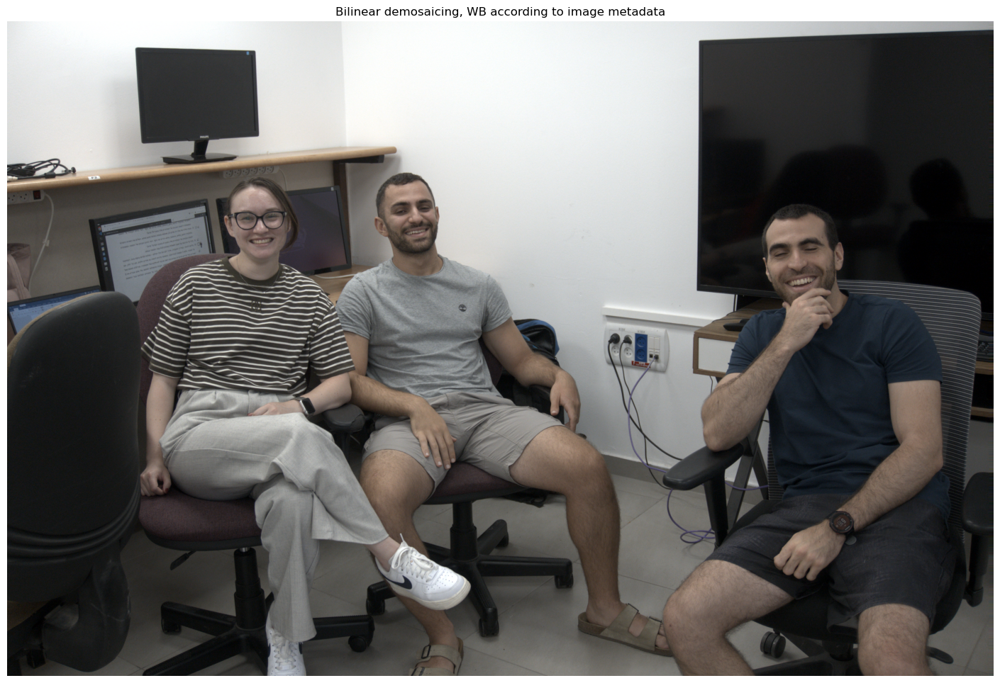

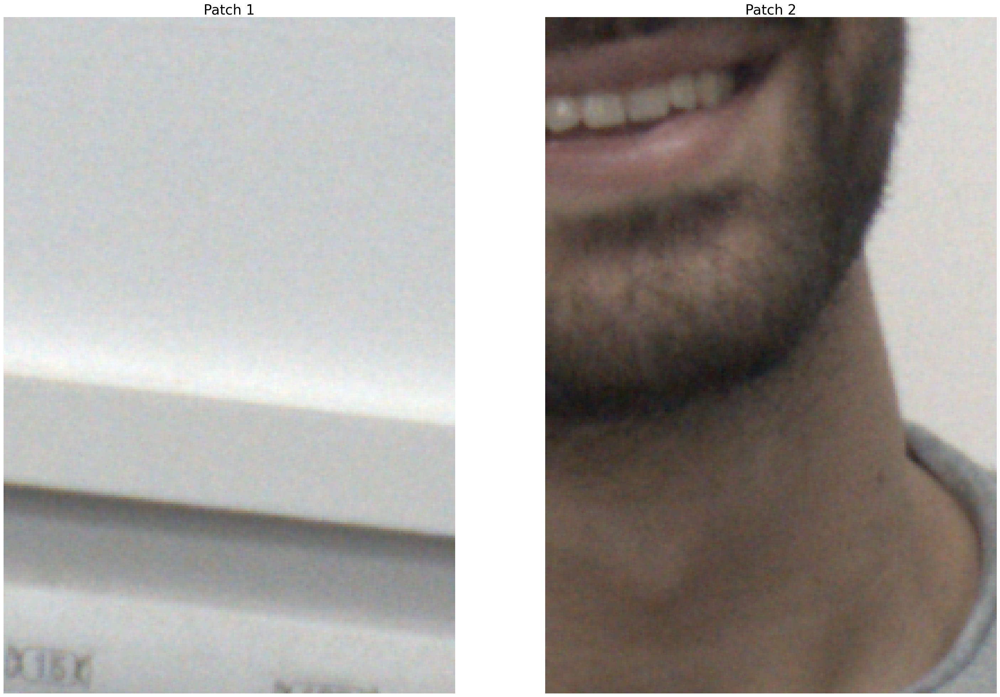

In [90]:
# Question 6

def demosaic_channel_bilinear(data, cfa_mask):
    """
    Bilinear demosaicing of a single channel by local-neighbor averaging. For each
    missing pixel, compute the mean over 8-connected known neighbors.

    Args:
        data(np.ndarray): Single-channel image with known values at CFA sample sites and
            arbitrary values elsewhere.
        cfa_mask(np.ndarray of bool): True where the value is known; False at missing
            sites.

    Returns:
        result(np.ndarray): Demosaiced image channel.
    """
    data = np.asarray(data, dtype=np.float32)
    cfa_mask = np.asarray(cfa_mask, dtype=bool)

    # If all pixels are known, return a copy
    if cfa_mask.all():
        return data.astype(np.float32, copy=True)

    result = data.copy()

    # Create padded arrays for easier neighbor access
    padded_data = np.pad(data, ((1, 1), (1, 1)), mode='edge')
    padded_mask = np.pad(cfa_mask, ((1, 1), (1, 1)), mode='constant', constant_values=False)

    # Get missing pixel positions
    Y, X = np.where(~cfa_mask)

    # Add 1 to Y and X for padded array indexing
    Y_pad = Y + 1
    X_pad = X + 1

    offsets = [(-1, -1), (-1, 0), (-1, 1),
               (0, -1),           (0, 1),
               (1, -1),  (1, 0),  (1, 1)]
    neighbor_sum = np.zeros_like(Y, dtype=np.float32)
    neighbor_count = np.zeros_like(Y, dtype=np.float32)

    # Check all neighbors
    for dy, dx in offsets:
        neighbor_values = padded_data[Y_pad + dy, X_pad + dx]
        valid_neighbors = padded_mask[Y_pad + dy, X_pad + dx]

        # TODO: Accumulate sum and count only over valid neighbors
        neighbor_sum += neighbor_values * valid_neighbors
        neighbor_count += valid_neighbors

    valid_pixels = neighbor_count > 0

    # TODO: Compute interpolated values where we have valid neighbors
    result[Y[valid_pixels], X[valid_pixels]] = (neighbor_sum[valid_pixels]/ neighbor_count[valid_pixels] )

    return result

# Demosaic R,G,B channels
demosaiced = np.zeros((height, width, 3), dtype=np.float32)
for i, mask in enumerate(all_masks):
    demosaiced[:, :, i] = demosaic_channel_bilinear(raw_data, mask)

# Apply color correction
color_corrected = white_balance_camera(demosaiced, black_levels, white_level, camera_wb)
color_corrected = apply_gamma_and_contrast(color_corrected)

# Show the image
plt.figure(figsize=(18, 12))
plt.imshow(color_corrected)
plt.axis('off')
plt.title('Bilinear demosaicing, WB according to image metadata')
plt.show()

# Show two image patches
patch1 = color_corrected[1674:1974, 3889:4089, :]
patch2 = color_corrected[1300:1600, 2578:2778, :]
plt.figure(figsize=(36, 30))
plt.subplot(1, 2, 1)
plt.imshow(patch1)
plt.axis('off')
plt.title('Patch 1', fontsize=28)

plt.subplot(1, 2, 2)
plt.imshow(patch2)
plt.axis('off')
plt.title('Patch 2', fontsize=28)

plt.show()


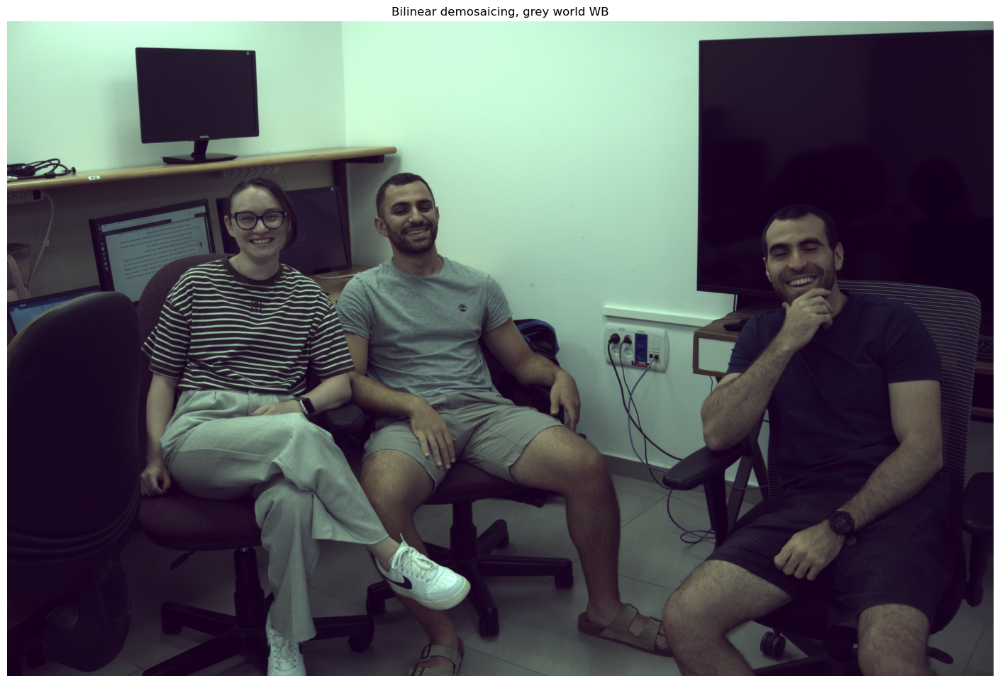

In [91]:
# Question 7

def white_balance_grey_world(image):
    """
    Grey-world white balance. Scale channels so their means match green.

    Args:
        image(np.ndarray): Input image.

    Returns:
        np.array: White balanced image.
    """
    result = np.asarray(image).astype(np.float32, copy=True)

    # Normalize to [0, 1]
    result /= np.max(result)

     # Find the average intensity of each channel
    avg_intensity = np.mean(result, axis=(0, 1))

    # TODO: Normalize to green channel
    wb_multipliers = avg_intensity[1] / (avg_intensity + 1e-8)

    # TODO: Apply white balance
    for c in range(3):
        result[:,:,c] *= wb_multipliers[c]

    return result

color_corrected_gw = white_balance_grey_world(demosaiced)
color_corrected_gw = apply_gamma_and_contrast(color_corrected_gw)

# Show the image
plt.figure(figsize=(18, 12))
plt.imshow(color_corrected_gw)
plt.axis('off')
plt.title('Bilinear demosaicing, grey world WB')
plt.show()


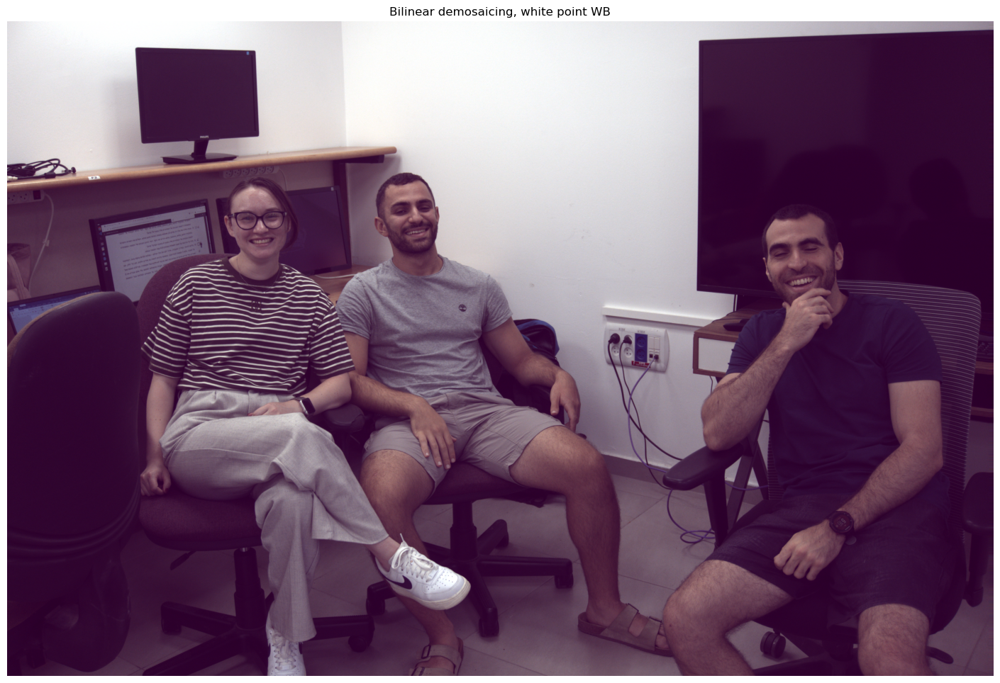

In [92]:
# Question 8

def white_balance_white_point(image, percentile=99):
    """
    White-point white balance using a robust high percentile per channel.

    Args:
        image(np.ndarray): Input image.
        percentile(float, optional): The high percentile used to estimate the channel
        white points. Default: 99.

    Returns:
        np.array: White balanced image.
    """
    result = np.asarray(image).astype(np.float32, copy=True)

    # Normalize to [0, 1]
    result /= np.max(result)

    # Find the white points for each channel
    # Using high percentile instead of maximum to avoid outliers
    white_points = np.percentile(result, percentile, axis=(0, 1))

    # TODO: Normalize to the max (1.0)
    wb_multipliers = 1.0 / white_points

    # TODO: Apply white balance
    for i in range(3):
        result[:,:,i] *= wb_multipliers[i]

    return result

color_corrected_wt = white_balance_white_point(demosaiced)
color_corrected_wt = apply_gamma_and_contrast(color_corrected_wt)

# Show the image
plt.figure(figsize=(18, 12))
plt.imshow(color_corrected_wt)
plt.axis('off')
plt.title('Bilinear demosaicing, white point WB')
plt.show()


# Assignment 3 - Denoising Using Spatial Filtering

In [93]:
# Questions 1-3

if not DISABLE_GUI:
    # Run image denoising app
    !python lab_code/im_denoising_app.py


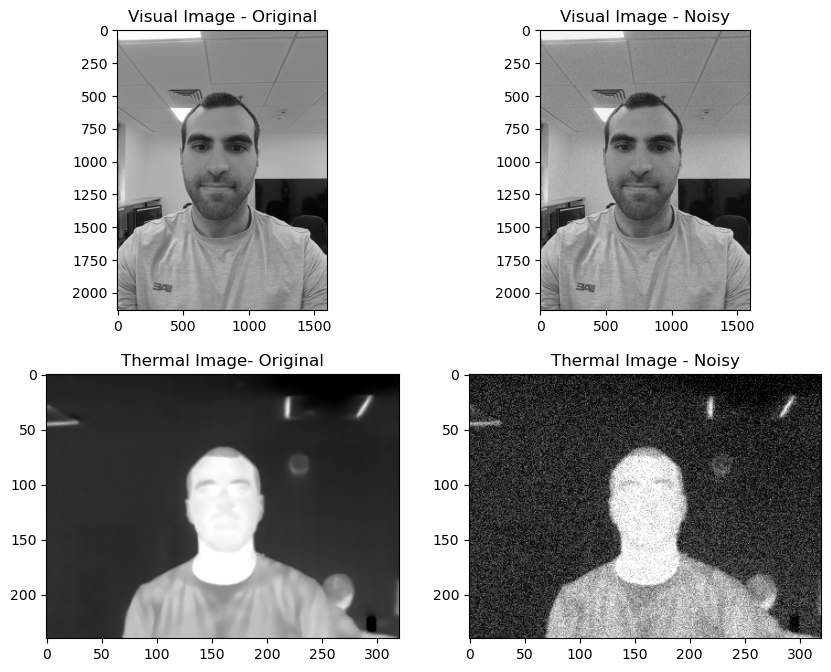

PSNR for visual noisy image: 20.13
PSNR for thermal noisy image: 20.56
SSIM for visual noisy image: 0.19
SSIM for thermal noisy image: 0.18


In [99]:
# Question 4

# TODO: Read visual image and prepare it for the lab
visual_image = visual_prep('C:/Users/ompal/Desktop/meet2/images/face.jpg')

# TODO: Read thermal image and prepare it for the lab
thermal_image_uint8 = thermal_prep_uint8('C:/Users/ompal/Desktop/meet2/images/face_thermal.jpg')

# TODO: Add White Gaussian Noise to the visual image
#       Use variance values of 0.01, 0.05, 0.1
noisy_visual = util.random_noise(visual_image/255, mode='gaussian', mean=0.0, var=0.01)
noisy_visual = 255*noisy_visual
noisy_visual = noisy_visual.astype(np.uint8)

# TODO: Add White Gaussian Noise to the thermal image
#       Use variance values of 0.01, 0.05, 0.1
noisy_thermal = util.random_noise(thermal_image_uint8/255, mode='gaussian', mean=0, var=0.01)
noisy_thermal = util.img_as_ubyte(noisy_thermal)

# Show the two original and the two noisy images
plt.figure(figsize=(10, 8))
plt.subplot(2, 2, 1)
plt.imshow(visual_image, cmap='gray')
plt.title('Visual Image - Original')
plt.subplot(2, 2, 2)
plt.imshow(noisy_visual, cmap='gray')
plt.title('Visual Image - Noisy')
plt.subplot(2, 2, 3)
plt.imshow(thermal_image_uint8, cmap='gray')
plt.title('Thermal Image- Original')
plt.subplot(2, 2, 4)
plt.imshow(noisy_thermal, cmap='gray')
plt.title('Thermal Image - Noisy')
plt.show()

# TODO: Calculate PSNR between original and noisy images
psnr_visual = metrics.peak_signal_noise_ratio(visual_image, noisy_visual)
psnr_thermal = metrics.peak_signal_noise_ratio(thermal_image_uint8, noisy_thermal)

print(f'PSNR for visual noisy image: {psnr_visual:.2f}')
print(f'PSNR for thermal noisy image: {psnr_thermal:.2f}')

# TODO: Calculate SSIM between original and noisy images
ssim_visual = metrics.structural_similarity(visual_image, noisy_visual, range=255)
ssim_thermal = metrics.structural_similarity(thermal_image_uint8, noisy_thermal, range=255)

print(f'SSIM for visual noisy image: {ssim_visual:.2f}')
print(f'SSIM for thermal noisy image: {ssim_thermal:.2f}')


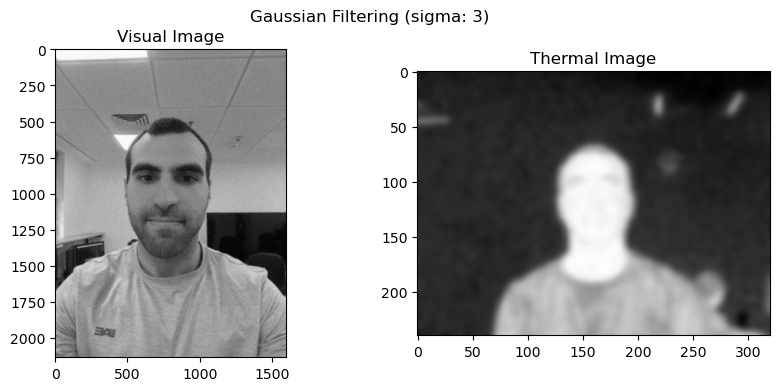

Sigma: 3
PSNR for visual Gaussian filtered image: 29.99
PSNR for thermal Gaussian filtered image: 29.01
SSIM for visual Gaussian filtered image: 0.74
SSIM for thermal Gaussian filtered image: 0.89


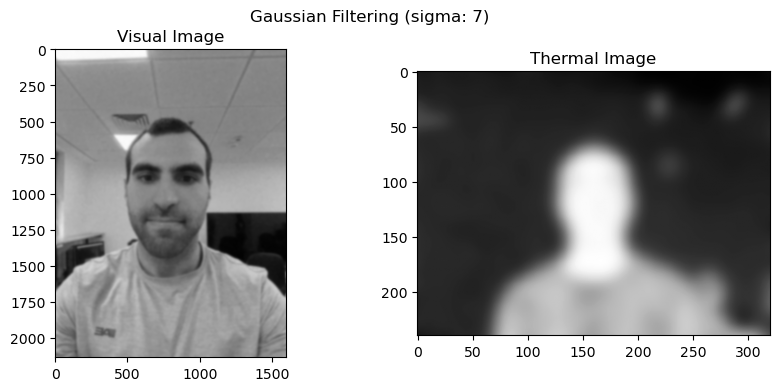

Sigma: 7
PSNR for visual Gaussian filtered image: 27.68
PSNR for thermal Gaussian filtered image: 24.13
SSIM for visual Gaussian filtered image: 0.70
SSIM for thermal Gaussian filtered image: 0.83


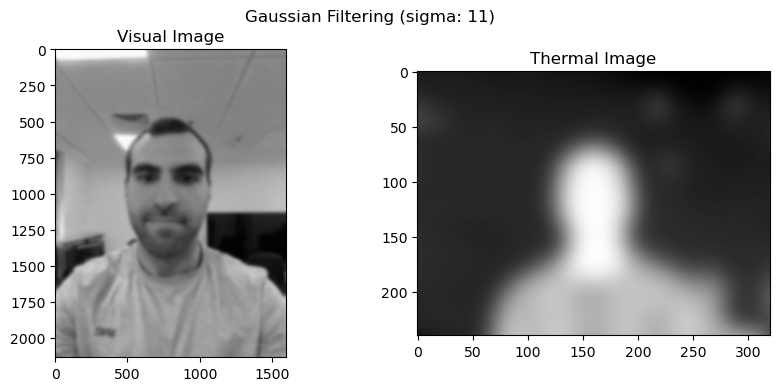

Sigma: 11
PSNR for visual Gaussian filtered image: 26.32
PSNR for thermal Gaussian filtered image: 21.75
SSIM for visual Gaussian filtered image: 0.69
SSIM for thermal Gaussian filtered image: 0.80


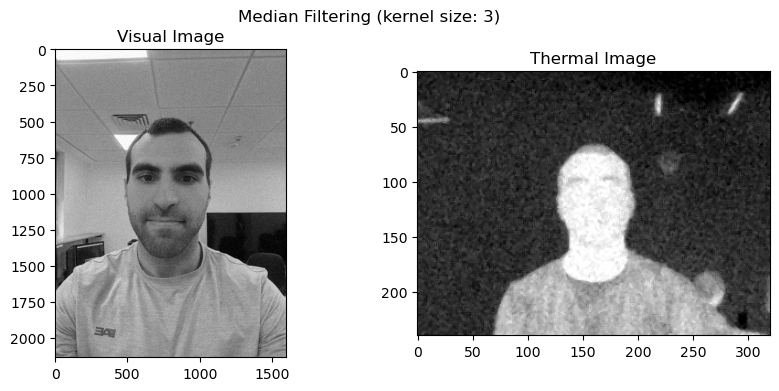

Kernel Size: 3
PSNR for visual median filtered image: 27.37
PSNR for thermal median filtered image: 27.76
SSIM for visual median filtered image: 0.50
SSIM for thermal median filtered image: 0.49


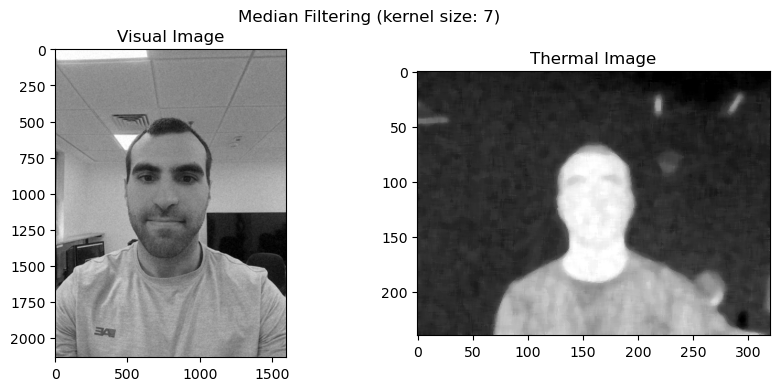

Kernel Size: 7
PSNR for visual median filtered image: 29.97
PSNR for thermal median filtered image: 31.83
SSIM for visual median filtered image: 0.67
SSIM for thermal median filtered image: 0.83


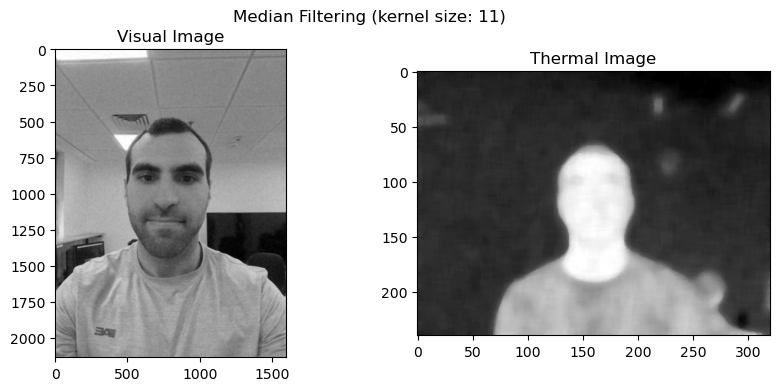

Kernel Size: 11
PSNR for visual median filtered image: 29.76
PSNR for thermal median filtered image: 30.09
SSIM for visual median filtered image: 0.70
SSIM for thermal median filtered image: 0.88


In [100]:
# Question 5

# Gaussian filtering
sigma_values = [3, 7, 11]
for sigma in sigma_values:
    # TODO: Filter the noisy visual image and noisy thermal image with Gaussian filter
    #       Use the 'filters.gaussian' function with sigma values of 3, 7, 11
    visual_image_gaussian = filters.gaussian(noisy_visual  / 255.0, sigma=sigma)     ########
    thermal_image_gaussian = filters.gaussian(noisy_thermal / 255.0, sigma=sigma)    ########
    visual_image_gaussian = util.img_as_ubyte(visual_image_gaussian)
    thermal_image_gaussian = util.img_as_ubyte(thermal_image_gaussian)

    # TODO: Show the two noisy images after Gaussian filtering
    plt.figure(figsize=(10, 4))
    plt.suptitle(f"Gaussian Filtering (sigma: {sigma})")
    plt.subplot(1, 2, 1)
    plt.imshow(visual_image_gaussian, cmap='gray')
    plt.title('Visual Image')
    plt.subplot(1, 2, 2)
    plt.imshow(thermal_image_gaussian, cmap='gray')
    plt.title('Thermal Image')
    plt.show()

    # TODO: Calculate PSNR & SSIM values between original and Gaussian filtered images
    #       Using 'skimage.metrics'
    psnr_visual_gaussian = metrics.peak_signal_noise_ratio(visual_image,        visual_image_gaussian,  data_range=255)   #########
    psnr_thermal_gaussian = metrics.peak_signal_noise_ratio(thermal_image_uint8, thermal_image_gaussian, data_range=255)  #########
    ssim_visual_gaussian = metrics.structural_similarity(visual_image,        visual_image_gaussian,  data_range=255)     #########
    ssim_thermal_gaussian = metrics.structural_similarity(thermal_image_uint8, thermal_image_gaussian, data_range=255)    #########

    print(f'Sigma: {sigma}')
    print(f'PSNR for visual Gaussian filtered image: {psnr_visual_gaussian:.2f}')
    print(f'PSNR for thermal Gaussian filtered image: {psnr_thermal_gaussian:.2f}')
    print(f'SSIM for visual Gaussian filtered image: {ssim_visual_gaussian:.2f}')
    print(f'SSIM for thermal Gaussian filtered image: {ssim_thermal_gaussian:.2f}')

# Median filtering
kernel_size_values = [3, 7, 11]
for kernel_size in kernel_size_values:
    # TODO: Filter the noisy visual image and noisy thermal image with median filter
    #       Use the 'filters.median' function with kernal size values of 3, 7, 11
    #       To select the kernel size, use the 'footprint' parameter with 'np.ones'
    fp = np.ones((kernel_size, kernel_size), dtype=bool  )                ##########    
    visual_image_median = filters.median(noisy_visual,  footprint=fp)     ##########
    thermal_image_median = filters.median(noisy_thermal, footprint=fp)    ##########

    # TODO: Show the two noisy images after median filtering
    plt.figure(figsize=(10, 4))
    plt.suptitle(f"Median Filtering (kernel size: {kernel_size})")
    plt.subplot(1, 2, 1)
    plt.imshow(visual_image_median, cmap='gray')
    plt.title('Visual Image')
    plt.subplot(1, 2, 2)
    plt.imshow(thermal_image_median, cmap='gray')
    plt.title('Thermal Image')
    plt.show()

    # TODO: Calculate PSNR & SSIM values between original and median filtered images
    #       Using 'skimage.metrics'
    psnr_visual_median = metrics.peak_signal_noise_ratio(visual_image,        visual_image_median,  data_range=255)     ########  
    psnr_thermal_median = metrics.peak_signal_noise_ratio(thermal_image_uint8, thermal_image_median, data_range=255)    ########
    ssim_visual_median = metrics.structural_similarity(visual_image,        visual_image_median,  data_range=255)       ########
    ssim_thermal_median = metrics.structural_similarity(thermal_image_uint8, thermal_image_median, data_range=255)      ########

    print(f'Kernel Size: {kernel_size}')
    print(f'PSNR for visual median filtered image: {psnr_visual_median:.2f}')
    print(f'PSNR for thermal median filtered image: {psnr_thermal_median:.2f}')
    print(f'SSIM for visual median filtered image: {ssim_visual_median:.2f}')
    print(f'SSIM for thermal median filtered image: {ssim_thermal_median:.2f}')

